# Understanding Customer Segmentation in Airlines Industry

In [1]:
import warnings
warnings.filterwarnings('ignore')
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objs as go
from plotly.subplots import make_subplots
import seaborn as sns

### 1.1 Data Understanding

In [2]:
df = pd.read_csv('flight.csv')

In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 62988 entries, 0 to 62987
Data columns (total 23 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   MEMBER_NO          62988 non-null  int64  
 1   FFP_DATE           62988 non-null  object 
 2   FIRST_FLIGHT_DATE  62988 non-null  object 
 3   GENDER             62985 non-null  object 
 4   FFP_TIER           62988 non-null  int64  
 5   WORK_CITY          60719 non-null  object 
 6   WORK_PROVINCE      59740 non-null  object 
 7   WORK_COUNTRY       62962 non-null  object 
 8   AGE                62568 non-null  float64
 9   LOAD_TIME          62988 non-null  object 
 10  FLIGHT_COUNT       62988 non-null  int64  
 11  BP_SUM             62988 non-null  int64  
 12  SUM_YR_1           62437 non-null  float64
 13  SUM_YR_2           62850 non-null  float64
 14  SEG_KM_SUM         62988 non-null  int64  
 15  LAST_FLIGHT_DATE   62988 non-null  object 
 16  LAST_TO_END        629

From the above description, date-related columns such as FFP_DATE, FIRST_FLIGHT_DATE, LOAD_TIME, and LAST_FLIGHT_DATE are stored as object data types. some columns have null or incomplete values such as WORK_CITY, WORK_PROVINCE, and AGE. This incomplete data can affect the analysis and needs to be handled using imputation techniques or removed depending on the amount and impact on the dataset.

In [4]:
# check duplication
df.duplicated().sum()

0

In [5]:
df.head()

,MEMBER_NO,FFP_DATE,FIRST_FLIGHT_DATE,GENDER,FFP_TIER,WORK_CITY,WORK_PROVINCE,WORK_COUNTRY,AGE,LOAD_TIME,...,SUM_YR_2,SEG_KM_SUM,LAST_FLIGHT_DATE,LAST_TO_END,AVG_INTERVAL,MAX_INTERVAL,EXCHANGE_COUNT,avg_discount,Points_Sum,Point_NotFlight
0,54993,11/2/2006,12/24/2008,Male,6,.,beijing,CN,31.0,3/31/2014,...,234188.0,580717,3/31/2014,1,3.483254,18,34,0.961639,619760,50
1,28065,2/19/2007,8/3/2007,Male,6,NaN,beijing,CN,42.0,3/31/2014,...,167434.0,293678,3/25/2014,7,5.194245,17,29,1.252314,415768,33
2,55106,2/1/2007,8/30/2007,Male,6,.,beijing,CN,40.0,3/31/2014,...,164982.0,283712,3/21/2014,11,5.298507,18,20,1.254676,406361,26
3,21189,8/22/2008,8/23/2008,Male,5,Los Angeles,CA,US,64.0,3/31/2014,...,125500.0,281336,12/26/2013,97,27.863636,73,11,1.090870,372204,12
4,39546,4/10/2009,4/15/2009,Male,6,guiyang,guizhou,CN,48.0,3/31/2014,...,130702.0,309928,3/27/2014,5,4.788079,47,27,0.970658,338813,39


Based on the snapshot of dataset head, we can say there are a number of main information we might be able to dig more, such as:
1. Customer Identification and Demographics: The MEMBER_NO uniquely identifies each customer. The GENDER and AGE columns describe the demographic profile. It's notable that the age of customers ranges from young adults to older individuals, suggesting a diverse customer base.
2. Loyalty and Engagement: The FFP_DATE and FIRST_FLIGHT_DATE indicate the start of the customer's relationship with the airline and their first flight, respectively. A shorter interval between these dates might suggest quicker engagement with the airline's services. The FFP_TIER shows the loyalty tier, which can influence the benefits received, like more points or discounts.
3. Flight Activity and Preferences: SEG_KM_SUM and FLIGHT_COUNT provide quantitative measures of how much and how often the customer flies. LAST_FLIGHT_DATE and LAST_TO_END (days since the last flight to the data snapshot date) help in understanding recent activity, which is crucial for determining customer recency in LRFM analysis.
4. Financial Expenditure and Rewards: SUM_YR_1 and SUM_YR_2 likely represent spending in consecutive years, while Points_Sum and avg_discount reflect the accumulation of loyalty points and the average discount rate enjoyed by the customer. High values in these columns could indicate high-value customers.
5. Customer Interaction: The EXCHANGE_COUNT reflects how often the customer exchanges points for rewards, indicating engagement with the loyalty program. Point_NotFlight might suggest points earned through non-flying activities, showing diverse engagement with the brand's offerings.

Since our goal is wanting to create cluster from the dataset, we need to consider some approaches related to customer segmentation. One of the most common one is through LFRMC apparoache.
1. Lenghth (L): FFP_DATE: The date when the customer joined the frequent flyer program. Membership duration can be calculated from this date to the last date in the data (usually LOAD_TIME) to measure how long the customer has been engaged with the program.
2. Frequency (F): FLIGHT_COUNT: Represents the number of times a customer flew during a certain period. It provides a direct measure of the frequency of customer interactions with airline services.
3. Recency (R): LAST_FLIGHT_DATE: The customer's last flight date indicates how recently the customer last interacted with the airline. The distance from this date to LOAD_TIME provides an indication of the freshness of customer activity.
4. Monetary (M): SUM_YR_1 dan SUM_YR_2: It shows customer's total spend on airline tickets during the first and second year after joining. The total sum of these two variables provides an idea of the customer's financial contribution to the airline
5. Monetary (M2):(SUM_YR_1 + SUM_YT_2)/SEG_KM_SUM
6. Contribution (C):  avg_discount: While not directly measuring financial contribution, the average discount level enjoyed by customers can provide insight into the value customers derive from the program, which can be correlated with how profitable those customers are to the airline. Points_Sum and EXCHANGE_COUNT: Shows how many points have been collected and redeemed, which can be a proxy for assessing a customer's contribution to additional activities such as partner purchases or participation in promotions.

In [6]:
numeric_cols = df.select_dtypes(['float64', 'int64']).columns.tolist()
category_cols = df.select_dtypes('object').columns.tolist()

In [7]:
df[numeric_cols].describe().T

,count,mean,std,min,25%,50%,75%,max
MEMBER_NO,62988.0,31494.500000,18183.213715,1.0,15747.750000,31494.500000,47241.250000,62988.0
FFP_TIER,62988.0,4.102162,0.373856,4.0,4.000000,4.000000,4.000000,6.0
AGE,62568.0,42.476346,9.885915,6.0,35.000000,41.000000,48.000000,110.0
FLIGHT_COUNT,62988.0,11.839414,14.049471,2.0,3.000000,7.000000,15.000000,213.0
BP_SUM,62988.0,10925.081254,16339.486151,0.0,2518.000000,5700.000000,12831.000000,505308.0
SUM_YR_1,62437.0,5355.376064,8109.450147,0.0,1003.000000,2800.000000,6574.000000,239560.0
SUM_YR_2,62850.0,5604.026014,8703.364247,0.0,780.000000,2773.000000,6845.750000,234188.0
SEG_KM_SUM,62988.0,17123.878691,20960.844623,368.0,4747.000000,9994.000000,21271.250000,580717.0
LAST_TO_END,62988.0,176.120102,183.822223,1.0,29.000000,108.000000,268.000000,731.0
AVG_INTERVAL,62988.0,67.749788,77.517866,0.0,23.370370,44.666667,82.000000,728.0


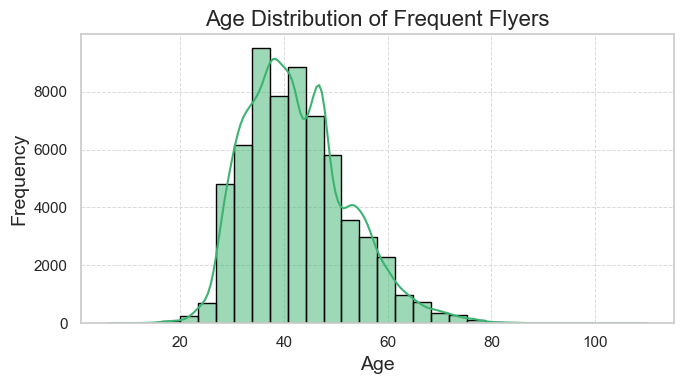

In [126]:
plt.figure(figsize=(7,4))
sns.histplot(df['AGE'], bins=30, kde=True, color="mediumseagreen", edgecolor='black')
plt.title('Age Distribution of Frequent Flyers', fontsize=16)
plt.xlabel('Age', fontsize=14)
plt.ylabel('Frequency', fontsize=14)
plt.grid(True, linestyle='--', linewidth=0.7, alpha=0.7)
plt.tight_layout()
plt.show()


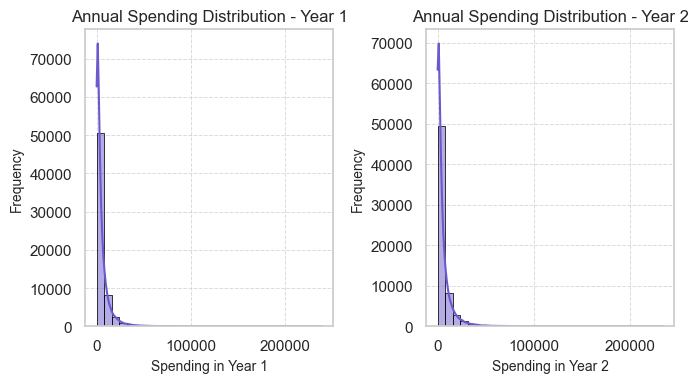

In [137]:
plt.figure(figsize=(7, 4))

# Subplot pertama untuk Year 1
plt.subplot(1, 2, 1)
sns.histplot(df['SUM_YR_1'].fillna(0), bins=30, kde=True, color="slateblue", edgecolor='black')
plt.title('Annual Spending Distribution - Year 1', fontsize=12)
plt.xlabel('Spending in Year 1', fontsize=10)
plt.ylabel('Frequency', fontsize=10)
plt.grid(True, linestyle='--', linewidth=0.7, alpha=0.7)

# Subplot kedua untuk Year 2
plt.subplot(1, 2, 2)
sns.histplot(df['SUM_YR_2'].fillna(0), bins=30, kde=True, color="slateblue", edgecolor='black')
plt.title('Annual Spending Distribution - Year 2', fontsize=12)
plt.xlabel('Spending in Year 2', fontsize=10)
plt.ylabel('Frequency', fontsize=10)
plt.grid(True, linestyle='--', linewidth=0.7, alpha=0.7)

# Mengatur layout agar tidak tumpang tindih
plt.tight_layout()

# Menampilkan plot
plt.show()



In [14]:
df['TOTAL_SPENT'] = df['SUM_YR_1'] + df['SUM_YR_2']

In [15]:
df[category_cols].describe()

,FFP_DATE,FIRST_FLIGHT_DATE,GENDER,WORK_CITY,WORK_PROVINCE,WORK_COUNTRY,LOAD_TIME,LAST_FLIGHT_DATE
count,62988,62988,62985,60719,59740,62962,62988,62988
unique,3068,3406,2,3234,1165,118,1,731
top,1/13/2011,2/16/2013,Male,guangzhou,guangdong,CN,3/31/2014,3/31/2014
freq,184,96,48134,9386,17509,57748,62988,959


The majority of passengers in this dataset are male, with many working in Guangzhou and Guangdong province in China, indicating the importance of this market. The data show a peak in FFP registrations in 2012, and the most common last flight date was March 31, 2014, indicating a specific analysis period. Airlines can leverage these insights to target more effective marketing and customer retention strategies.

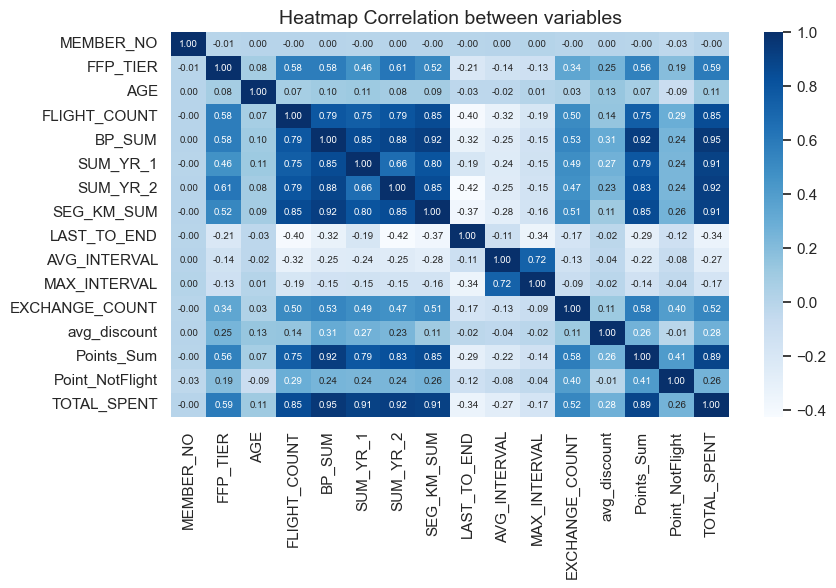

In [141]:
plt.rc('font', size=7)
plt.figure(figsize=(9, 5))

sns.heatmap(df.corr(numeric_only=True), annot=True, fmt='.2f', cmap='Blues', annot_kws={"size": 7})
plt.title('Heatmap Correlation between variables', fontsize=14)
plt.show()

### 1.2 Data Preprocessing

Now we are going to preprocessing variables we consider will affect the customer segmentation based on LRFMC approaches. In this case, variables outside what we have mentioned above would not be considered on this analysis.

In [17]:
#make a copy
df_preprocessing = df.copy()

In [18]:
# Convert date columns to datetime with error handling
df_preprocessing['FFP_DATE'] = pd.to_datetime(df_preprocessing['FFP_DATE'], errors='coerce')
df_preprocessing['FIRST_FLIGHT_DATE'] = pd.to_datetime(df_preprocessing['FIRST_FLIGHT_DATE'], errors='coerce')
df_preprocessing['LOAD_TIME'] = pd.to_datetime(df_preprocessing['LOAD_TIME'], errors='coerce')
df_preprocessing['LAST_FLIGHT_DATE'] = pd.to_datetime(df_preprocessing['LAST_FLIGHT_DATE'], errors='coerce')

there are rows with the input date of February 29th in a non-leap year, so it is not detected as a date so we add error handling (Not a Time)

In [19]:
# Menampilkan jumlah NaT untuk kolom tanggal yang spesifik
date_columns = ['FFP_DATE', 'FIRST_FLIGHT_DATE', 'LOAD_TIME', 'LAST_FLIGHT_DATE']
nat_counts = df_preprocessing[date_columns].isna().sum()

nat_counts

FFP_DATE               0
FIRST_FLIGHT_DATE      0
LOAD_TIME              0
LAST_FLIGHT_DATE     421
dtype: int64

## Csutomer Segmentation

When we are looking at the data, there was found Not a Time (NaT) in Last_flight_date column with 421 entries.

In [20]:
# Descriptive statistics for datetime columns
date_descriptive_stats = df_preprocessing[['FFP_DATE', 'FIRST_FLIGHT_DATE', 'LAST_FLIGHT_DATE']].describe()
date_descriptive_stats

,FFP_DATE,FIRST_FLIGHT_DATE,LAST_FLIGHT_DATE
count,62988,62988,62567
mean,2010-03-06 23:58:48.672128,2010-09-01 17:59:44.911411968,2013-10-06 15:32:03.103233280
min,2004-11-01 00:00:00,1905-12-31 00:00:00,2012-04-01 00:00:00
25%,2008-04-12 00:00:00,2008-12-14 18:00:00,2013-07-07 00:00:00
50%,2010-10-08 00:00:00,2011-04-23 00:00:00,2013-12-14 00:00:00
75%,2012-03-29 00:00:00,2012-07-26 00:00:00,2014-03-03 00:00:00
max,2013-03-31 00:00:00,2015-05-30 00:00:00,2014-03-31 00:00:00


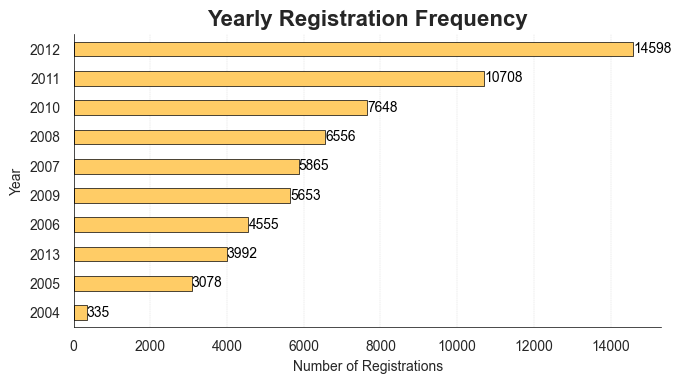

In [135]:
import matplotlib.pyplot as plt
import seaborn as sns

# Set the style
sns.set(style="white")

# Frequency of registrations per year
yearly_counts = df_preprocessing['FFP_DATE'].groupby(df_preprocessing['FFP_DATE'].dt.year).count()

plt.figure(figsize=(7,4))
ax = yearly_counts.sort_values().plot(kind='barh', color='#FFCC66', edgecolor='black', linewidth=0.5, width=0.5)

plt.title('Yearly Registration Frequency', fontsize=16, weight='bold')
plt.xlabel('Number of Registrations', fontsize=10)
plt.ylabel('Year', fontsize=10)

plt.xticks(fontsize=10)
plt.yticks(fontsize=10)

ax.grid(True, which='both', axis='x', linestyle='--', linewidth=0.25)

ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

for index, value in enumerate(yearly_counts.sort_values()):
    ax.text(value, index, str(value), va='center', ha='left', fontsize=10, color='black')

for spine in ax.spines.values():
    spine.set_edgecolor('black')
    spine.set_linewidth(0.5)


plt.tight_layout()
plt.show()


### 1. Length (L)

In [22]:
# Calculate Length (L) as the number of days of membership
df_preprocessing['Length'] = (df_preprocessing['LOAD_TIME'] - df_preprocessing['FFP_DATE']).dt.days

# Show the result
df_preprocessing[['FFP_DATE', 'LOAD_TIME', 'Length']].head()

,FFP_DATE,LOAD_TIME,Length
0,2006-11-02,2014-03-31,2706
1,2007-02-19,2014-03-31,2597
2,2007-02-01,2014-03-31,2615
3,2008-08-22,2014-03-31,2047
4,2009-04-10,2014-03-31,1816


In [23]:
df_preprocessing[['FFP_DATE', 'LOAD_TIME', 'Length']].describe()

,FFP_DATE,LOAD_TIME,Length
count,62988,62988,62988.000000
mean,2010-03-06 23:58:48.672128,2014-03-30 23:59:59.999999744,1485.000826
min,2004-11-01 00:00:00,2014-03-31 00:00:00,365.000000
25%,2008-04-12 00:00:00,2014-03-31 00:00:00,732.000000
50%,2010-10-08 00:00:00,2014-03-31 00:00:00,1270.000000
75%,2012-03-29 00:00:00,2014-03-31 00:00:00,2179.000000
max,2013-03-31 00:00:00,2014-03-31 00:00:00,3437.000000
std,NaN,NaN,847.222941


This dataset summary is a study of membership durations, containing 62,988 entries with no missing entries It spans memberships starting from November 1, 2004, up to a uniform end date of March 31, 2014, with participation lengths varying from 365 to 3,437 days. The average participation period is about 1,485 days, showcasing a broad range of membership durations within the dataset.

In [24]:
df_preprocessing['FLIGHT_COUNT'].describe()

count    62988.000000
mean        11.839414
std         14.049471
min          2.000000
25%          3.000000
50%          7.000000
75%         15.000000
max        213.000000
Name: FLIGHT_COUNT, dtype: float64

The data indicates that on average, customers have taken about 11.84 flights, but with a high standard deviation of approximately 14.05, pointing to significant variability in the flight counts. Most customers have taken 15 or fewer flights, as shown by the 75th percentile, yet there are customers who have taken as many as 213 flights, suggesting the presence of extremely frequent flyers which could potentially be outliers in the dataset

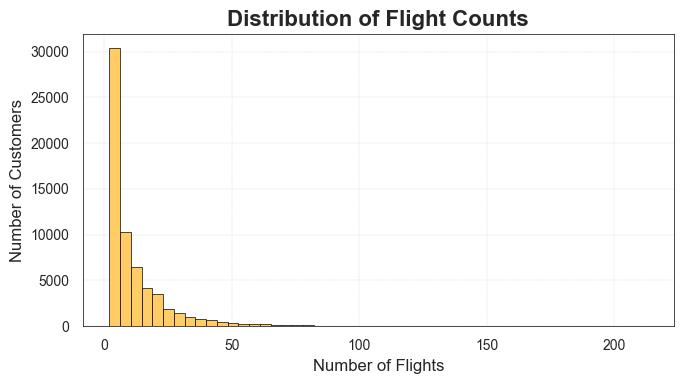

In [136]:
import matplotlib.pyplot as plt
import seaborn as sns

sns.set(style="whitegrid")

plt.figure(figsize=(7,4))
ax = df_preprocessing['FLIGHT_COUNT'].hist(bins=50, color='#FFCC66', edgecolor='black', linewidth=0.5)

plt.title('Distribution of Flight Counts', fontsize=16, weight='bold')
plt.xlabel('Number of Flights', fontsize=12)
plt.ylabel('Number of Customers', fontsize=12)

plt.xticks(fontsize=10)
plt.yticks(fontsize=10)

ax.grid(True, which='both', axis='both', linestyle='--', linewidth=0.25)

for spine in ax.spines.values():
    spine.set_edgecolor('black')
    spine.set_linewidth(0.5)

# Display the plot
plt.tight_layout()
plt.show()


The graph above shows some information about the customers:
1. The distribution is right-skewed, meaning there are more customers with a lower number of flights and fewer customers as the number of flights increases.
2. Most Customers Are Infrequent Flyers: The highest frequency is in the lowest bin, suggesting that the largest group of customers has flown only a small number of times. This indicates that the majority of customers in the dataset might be considered infrequent flyers.
3. Long Tail of Frequent Flyers: There is a long tail extending to the right, which shows that there is a small number of customers who have flown very frequently. These customers represent the high-value segment that could be targeted with loyalty programs and other retention strategies.
4. Potential Outliers: The customers represented by the bars farthest to the right, especially those close to the maximum flight count of 200 or more, may be outliers. They have a flight count significantly higher than the rest of the customer base and could be of particular interest for special marketing campaigns or service offers.
5. Volume of Lower Frequency Segments: Given the steep drop-off after the first few bins, it can be inferred that a significant portion of the customer base has a flight count that falls within the 25th percentile of the distribution.

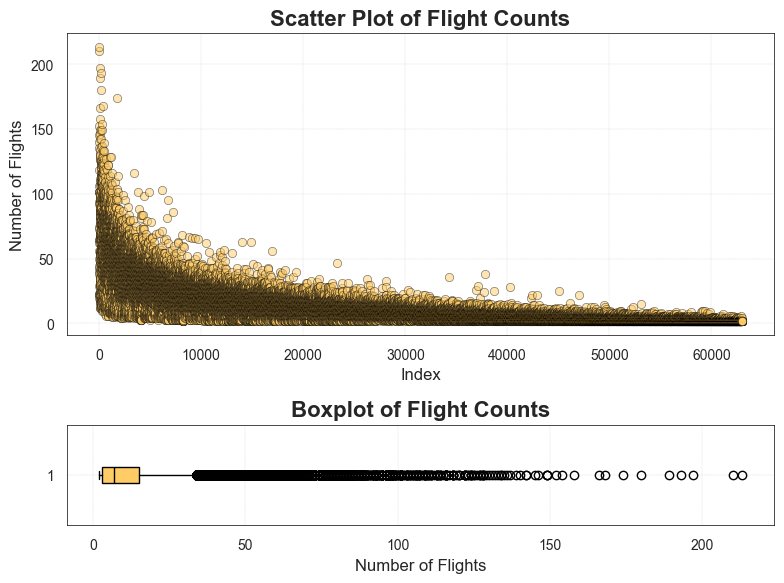

In [111]:
import matplotlib.pyplot as plt
import seaborn as sns

# Set the style
sns.set(style="whitegrid")

# Create a figure with two subplots: one for the scatter plot and one for the box plot
fig, axs = plt.subplots(2, 1, figsize=(8, 6), gridspec_kw={'height_ratios': [3, 1]})

# Scatter plot of flight counts
axs[0].scatter(df_preprocessing.index, df_preprocessing['FLIGHT_COUNT'], alpha=0.5, color='#FFCC66', edgecolor='black', linewidth=0.5)
axs[0].set_title('Scatter Plot of Flight Counts', fontsize=16, weight='bold')
axs[0].set_xlabel('Index', fontsize=12)
axs[0].set_ylabel('Number of Flights', fontsize=12)
axs[0].tick_params(axis='both', which='major', labelsize=10)
axs[0].grid(True, which='both', axis='both', linestyle='--', linewidth=0.25)

# Add border to scatter plot
for spine in axs[0].spines.values():
    spine.set_edgecolor('black')
    spine.set_linewidth(0.5)

# Box plot of flight counts
axs[1].boxplot(df_preprocessing['FLIGHT_COUNT'], vert=False, patch_artist=True, boxprops=dict(facecolor='#FFCC66', color='black'), 
               medianprops=dict(color='black'), whiskerprops=dict(color='black'), capprops=dict(color='black'))
axs[1].set_title('Boxplot of Flight Counts', fontsize=16, weight='bold')
axs[1].set_xlabel('Number of Flights', fontsize=12)
axs[1].tick_params(axis='both', which='major', labelsize=10)
axs[1].grid(True, which='both', axis='both', linestyle='--', linewidth=0.25)

# Add border to box plot
for spine in axs[1].spines.values():
    spine.set_edgecolor('black')
    spine.set_linewidth(0.5)

# Adjust layout
plt.tight_layout()
plt.show()


The boxplot suggests that while most customers fly a relatively small number of times, there are a few customers who fly very frequently, and these could be of particular interest to the airline for targeted marketing and loyalty programs. It would be beneficial for the business to further investigate the outliers to understand if they represent a segment of high-value customers or if there are any data recording errors.we still need more information related to the data

### 3. Recency

the presence of 421 NaT (Not a Time) values in 'LAST_FLIGHT_DATE' feature column indicates missing data for the customers' last interaction date. These need to be addressed before calculating recency since we could not subtract a date from a non-existent value.

In [27]:
df_2 = df_preprocessing.copy()

In [28]:
# Calculate Recency
df_2['Recency'] = (df_2['LOAD_TIME'] - df_2['LAST_FLIGHT_DATE']).dt.days

In [29]:
df_2[['LOAD_TIME','LAST_FLIGHT_DATE', 'Recency']].head()

,LOAD_TIME,LAST_FLIGHT_DATE,Recency
0,2014-03-31,2014-03-31,0.0
1,2014-03-31,2014-03-25,6.0
2,2014-03-31,2014-03-21,10.0
3,2014-03-31,2013-12-26,95.0
4,2014-03-31,2014-03-27,4.0


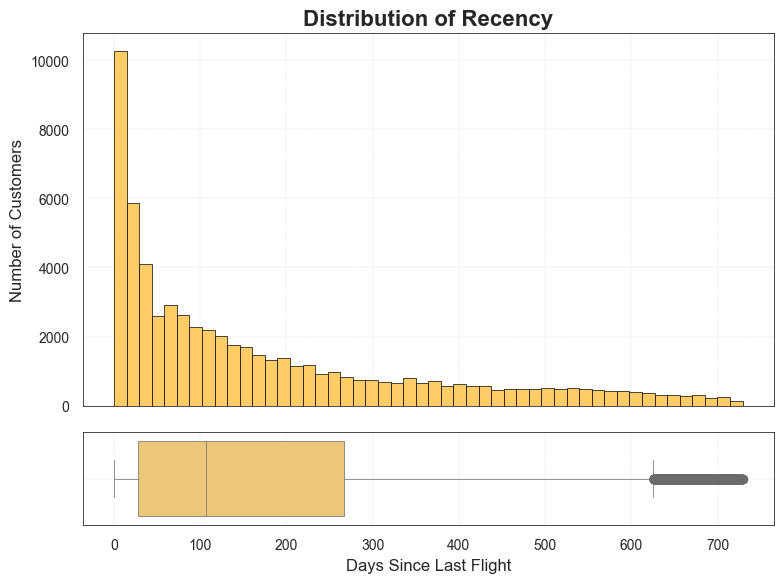

In [110]:

sns.set(style="whitegrid")

fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(8, 6), gridspec_kw={'height_ratios': [4, 1]}, sharex=True)

ax1.hist(df_2['Recency'], bins=50, color='#FFCC66', edgecolor='black', linewidth=0.5)
ax1.set_title('Distribution of Recency', fontsize=16, weight='bold')
ax1.set_ylabel('Number of Customers', fontsize=12)
ax1.grid(True, which='both', axis='both', linestyle='--', linewidth=0.25)
ax1.tick_params(axis='both', which='major', labelsize=10)
sns.boxplot(x=df_2['Recency'], ax=ax2, color='#FFCC66', linewidth=0.5)
ax2.set_xlabel('Days Since Last Flight', fontsize=12)
ax2.grid(True, linestyle='--', linewidth=0.25)
ax2.tick_params(axis='both', which='major', labelsize=10)
for ax in [ax1, ax2]:
    for spine in ax.spines.values():
        spine.set_edgecolor('black')
        spine.set_linewidth(0.5)

plt.tight_layout()
plt.show()


In [32]:
df_2['Recency'].describe()

count    62567.000000
mean       175.352742
std        183.823946
min          0.000000
25%         28.000000
50%        107.000000
75%        267.000000
max        729.000000
Name: Recency, dtype: float64

The descriptive statistics for the Recency variable in thhis dataset show a range from 0 to 729 days, with a mean of approximately 175 days and a median of 107 days, indicating a right-skewed distribution where most customers have flown more recently than the average suggests. The standard deviation of about 184 days highlights a wide variation in the time since customers' last flights, pointing to diverse customer engagement patterns. The first quartile at 28 days shows that 25% of customers have flown within the last month, while the third quartile at 267 days reveals that 75% flew within the last nine months, suggesting a significant gap in engagement frequency among customers

The boxplot illustrates the recency of customer flights, with the bulk of customers having flown more recently than the rightmost edge of the box suggests, due to the plot’s right skew. The long right whisker indicates that a smaller number of customers have not flown for a long period, up to about two years (729 days). Outliers are not readily visible, which suggests that the maximum recency value is not far beyond the range typical of most customers.

In [33]:
df_3 = df_2.copy()

In [34]:
# when we drop NaT on out dataset
df_3 = df_3.dropna(subset=['LAST_FLIGHT_DATE'])

In [35]:
df_3['Recency'].head()

0     0.0
1     6.0
2    10.0
3    95.0
4     4.0
Name: Recency, dtype: float64

In [36]:
total_rows = 62988  # Total number of rows in the dataset
rows_with_missing_last_flight_date = 421  # Rows you plan to remove

# Calculate the percentage of data that will be removed
percentage_removed = (rows_with_missing_last_flight_date / total_rows) * 100
percentage_removed

0.6683812789737729

In [37]:
df_3['Recency'].describe()

count    62567.000000
mean       175.352742
std        183.823946
min          0.000000
25%         28.000000
50%        107.000000
75%        267.000000
max        729.000000
Name: Recency, dtype: float64

nothing really changes for we have no different on the stats calculation

### 4. Monetary (M)

In [38]:
# Check for missing values in SUM_YR_1 and SUM_YR_2
missing_values_sum_yr_1 = df_3['SUM_YR_1'].isna().sum()
missing_values_sum_yr_2 = df_3['SUM_YR_2'].isna().sum()

In [39]:
print(f"missing values sum_yr_1: {missing_values_sum_yr_1} and missing values sum_yr_2: {missing_values_sum_yr_2}")

missing values sum_yr_1: 551 and missing values sum_yr_2: 138


In [40]:
# Get the indices of rows with missing 'SUM_YR_1'
missing_sum_yr_1_indices = df_3[df_3['SUM_YR_1'].isnull()].index.tolist()

In [41]:
# Get the indices of rows with missing 'SUM_YR_2'
missing_sum_yr_2_indices = df_3[df_3['SUM_YR_2'].isnull()].index.tolist()

In [42]:
# Find the common indices in both lists
common_indices = list(set(missing_sum_yr_1_indices) & set(missing_sum_yr_2_indices))

In [43]:
# Check if there are any common indices
has_common_indices = len(common_indices) > 0
has_common_indices

False

has_common_indices results in False meaning there are no rows where both SUM_YR_1 and SUM_YR_2 are missing simultaneously. Therefore, the missing values in SUM_YR_1 and SUM_YR_2 occur in different rows.

Considering we have already reduced our dataset from 62,988 to 62,567 by removing the 421 rows with NaT values, subtracting an additional 689 rows would bring our dataset size to 61,878. TWe need to calculate to ensure that it is within an acceptable threshold for our analysis. If this does not significantly compromise the dataset's integrity or the analysis's goals, we may proceed with the removal.

In [44]:
# Calculate 'Monetary' as the sum of 'SUM_YR_1' and 'SUM_YR_2'
df_3['Monetary'] = df_3['SUM_YR_1'].fillna(0) + df_3['SUM_YR_2'].fillna(0)

In [45]:
df_3['Monetary'].describe()

count     62567.000000
mean      10881.693533
std       15327.983671
min           0.000000
25%        2686.000000
50%        5827.000000
75%       12933.000000
max      473748.000000
Name: Monetary, dtype: float64

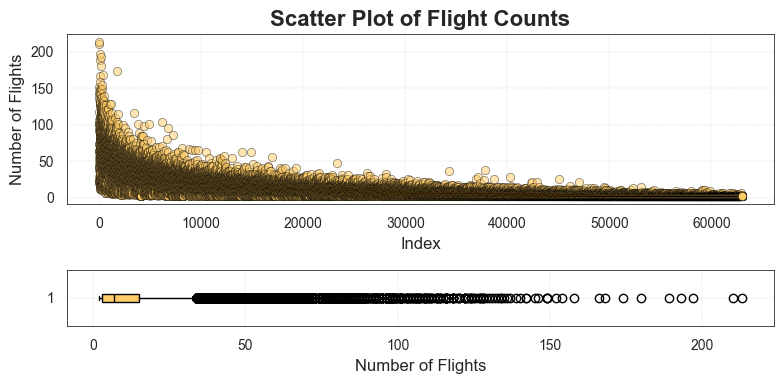

In [109]:
sns.set(style="whitegrid")

fig, axs = plt.subplots(2, 1, figsize=(8, 4), gridspec_kw={'height_ratios': [3, 1]})

axs[0].scatter(df_preprocessing.index, df_preprocessing['FLIGHT_COUNT'], alpha=0.5, color='#FFCC66', edgecolor='black', linewidth=0.5)
axs[0].set_title('Scatter Plot of Flight Counts', fontsize=16, weight='bold')
axs[0].set_xlabel('Index', fontsize=12)
axs[0].set_ylabel('Number of Flights', fontsize=12)
axs[0].tick_params(axis='both', which='major', labelsize=10)
axs[0].grid(True, which='both', axis='both', linestyle='--', linewidth=0.25)

for spine in axs[0].spines.values():
    spine.set_edgecolor('black')
    spine.set_linewidth(0.5)

axs[1].boxplot(df_preprocessing['FLIGHT_COUNT'], vert=False, patch_artist=True, boxprops=dict(facecolor='#FFCC66', color='black'), 
               medianprops=dict(color='black'), whiskerprops=dict(color='black'), capprops=dict(color='black'))
axs[1].set_xlabel('Number of Flights', fontsize=12)
axs[1].tick_params(axis='both', which='major', labelsize=10)
axs[1].grid(True, which='both', axis='both', linestyle='--', linewidth=0.25)
for spine in axs[1].spines.values():
    spine.set_edgecolor('black')
    spine.set_linewidth(0.5)

plt.tight_layout()
plt.show()


### 5 Monetary 2 (M2)

In [48]:
# Calculate M2
df_3['M2'] = (df_3['SUM_YR_1'] + df_3['SUM_YR_2']) / df_3['SEG_KM_SUM']

# Check the first few results to ensure correctness
df_3[['SUM_YR_1', 'SUM_YR_2', 'SEG_KM_SUM', 'M2']].head()

,SUM_YR_1,SUM_YR_2,SEG_KM_SUM,M2
0,239560.0,234188.0,580717,0.815798
1,171483.0,167434.0,293678,1.154043
2,163618.0,164982.0,283712,1.158217
3,116350.0,125500.0,281336,0.859648
4,124560.0,130702.0,309928,0.823617


In [49]:
df_3[['SUM_YR_1', 'SUM_YR_2', 'SEG_KM_SUM', 'M2']].info()

<class 'pandas.core.frame.DataFrame'>
Index: 62567 entries, 0 to 62987
Data columns (total 4 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   SUM_YR_1    62016 non-null  float64
 1   SUM_YR_2    62429 non-null  float64
 2   SEG_KM_SUM  62567 non-null  int64  
 3   M2          61878 non-null  float64
dtypes: float64(3), int64(1)
memory usage: 2.4 MB


In [50]:
df_3[['SUM_YR_1', 'SUM_YR_2', 'SEG_KM_SUM', 'M2']].describe()

,SUM_YR_1,SUM_YR_2,SEG_KM_SUM,M2
count,62016.000000,62429.000000,62567.000000,61878.000000
mean,5352.327839,5588.828205,17095.441159,0.643732
std,8116.830365,8707.792799,20974.464921,0.282815
min,0.000000,0.000000,368.000000,0.000000
25%,1005.750000,768.000000,4732.000000,0.484974
50%,2800.000000,2756.000000,9959.000000,0.619642
75%,6567.000000,6815.000000,21206.000000,0.755119
max,239560.000000,234188.000000,580717.000000,5.202103


The dataset summary for Monetary 2 (M2), a measure of monetary efficiency (spending per kilometer), shows that on average, customers spend approximately 0.644 units of currency per kilometer, with a standard deviation of 0.283, meaning that some variability in how efficiently different customers spend relative to the distance they travel. The range for M2 spans from 0 (no spending or extremely efficient spending relative to distance) up to a maximum of 5.202, which suggests there are some extreme cases where customers spend significantly more per kilometer. The distribution is somewhat right-skewed, as the mean is slightly higher than the median (0.620), and the 75th percentile value of M2 is 0.755 which means that the top 25% of the customers have a higher spending rate per kilometer. The minimum value for SEG_KM_SUM is 368 kilometers which says that all calculations for M2 are based on a reasonable amount of travel distance. This metric (M2) can be particularly useful for identifying both high-value customers (with higher M2) and those who might be more cost-conscious(lower value of M2). From this feature as well we can obtain values per mile traveled.

### 6. Contribution/Customer Values (C)

In [52]:
df_3[['avg_discount', 'Points_Sum', 'EXCHANGE_COUNT']].describe()

,avg_discount,Points_Sum,EXCHANGE_COUNT
count,62567.000000,62567.000000,62567.000000
mean,0.721555,12524.515959,0.319306
std,0.185485,20524.415318,1.137151
min,0.000000,0.000000,0.000000
25%,0.611875,2764.000000,0.000000
50%,0.711826,6303.000000,0.000000
75%,0.809611,14249.000000,0.000000
max,1.500000,985572.000000,46.000000


In [53]:
df_3[['avg_discount', 'Points_Sum', 'EXCHANGE_COUNT']].info()

<class 'pandas.core.frame.DataFrame'>
Index: 62567 entries, 0 to 62987
Data columns (total 3 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   avg_discount    62567 non-null  float64
 1   Points_Sum      62567 non-null  int64  
 2   EXCHANGE_COUNT  62567 non-null  int64  
dtypes: float64(1), int64(2)
memory usage: 1.9 MB


The dataset contains 62,567 records for `avg_discount`, `Points_Sum`, and `EXCHANGE_COUNT`, all fully populated with no missing values. The average discount rate is roughly 0.722 with minimum variation (std: 0.185), meaning that there are consistent discount levels across most customers. However, `Points_Sum` shows significant variation, ranging from 0 to a maximum of 985,572, pointing to notable outliers in how points are accrued. For `EXCHANGE_COUNT`, while most customers (75%) have not made any exchanges, a maximum count of 46 highlights a small segment of highly active participants.

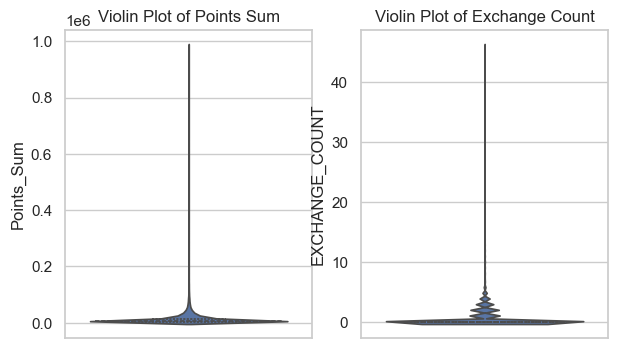

In [146]:
plt.figure(figsize=(7, 4))
plt.subplot(1, 2, 1)
sns.violinplot(y=df_3['Points_Sum'], inner='quartile')
plt.title('Violin Plot of Points Sum')

plt.subplot(1, 2, 2)
sns.violinplot(y=df_3['EXCHANGE_COUNT'], inner='quartile')
plt.title('Violin Plot of Exchange Count')

# Menampilkan plot
plt.show()

the data for Points_Sum is highly concentrated near the lower end of the scale, indicating that most customers have accumulated a relatively small number of points, but there are some with significantly higher values(?), evidenced by outlier reaching 1 million. In the EXCHANGE_COUNT, most customers seemingly have not engaged in many exchanges, as seen by the concentration of data at the bottom of the plot, and again, there are notable outliers with counts as high as 40, indicating that a few customers are extremely active in redeeming their points.
Both plots show that in this context, while typical customer behavior involves lower points and exchange counts, there are exceptional cases that may represent particularly engaged or high-value customers. In business contect, these outliers could also be considered to become key targets for retention and upselling strategies.

Remember there are still about 689 missing entries on Monetary and Monetary 2 (M2) so in order to make sure there is no NAN data on the data set, we will drop the missing entries

In [56]:
# Check for NaN values across the DataFrame
nan_values = df_3.isna().sum()
nan_values

MEMBER_NO               0
FFP_DATE                0
FIRST_FLIGHT_DATE       0
GENDER                  3
FFP_TIER                0
WORK_CITY            2255
WORK_PROVINCE        3226
WORK_COUNTRY           25
AGE                   419
LOAD_TIME               0
FLIGHT_COUNT            0
BP_SUM                  0
SUM_YR_1              551
SUM_YR_2              138
SEG_KM_SUM              0
LAST_FLIGHT_DATE        0
LAST_TO_END             0
AVG_INTERVAL            0
MAX_INTERVAL            0
EXCHANGE_COUNT          0
avg_discount            0
Points_Sum              0
Point_NotFlight         0
TOTAL_SPENT           689
Length                  0
Recency                 0
Monetary                0
M2                    689
dtype: int64

In [57]:
# make a copy of df_3 cos we will drop rows
df_4 = df_3.copy()

In [58]:
# drop the rows
df_4 = df_4.dropna(subset=['M2'])

In [59]:
print(df_4.shape)

(61878, 28)


In [60]:
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()
df_4[['avg_discount_standardized', 'Points_Sum_standardized', 'EXCHANGE_COUNT_standardized']] = scaler.fit_transform(
    df_4[['avg_discount', 'Points_Sum', 'EXCHANGE_COUNT']]
)

Even though we are using standarscaller in order to get the customer values, we still need to weight each features/component 'avg_discount', 'Points_Sum', 'EXCHANGE_COUNT'. Here I consider the statistics describtion from above analysis:

1. avg_discount shows moderate variability with a standard deviation of 0.185. It doesn't have a wide range from min to max (0 to 1.5), meaning there is a relatively consistent discount behavior among customers.
2. Points_Sum has a substantial range and standard deviation, indicating significant variability in how customers accumulate points. This is suggesting that Points_Sum could be a crucial indicator of customer engagement and potential value.
3. EXCHANGE_COUNT has a low average but a relatively high maximum and standard deviation. This is indicating that while most customers may not engage frequently in exchanges, those who do are highly active. This could indicate deep engagement among a smaller group of customers.

Weight justification. So based on the data insights, we can try to consider:
- Weight for avg_discount --> lower weight because its impact on revenue might be less direct compared to points activities since its smaller standard deviation and tighter range,
- Weight for Points_Sum --> Higher weight due to its high variability and potential indication of customer engagement and spending.
- Weight for EXCHANGE_COUNT --> Moderately high weight to reflect its importance in indicating highly engaged customers, despite fewer customers participating.

another assumption can also be calculated through linear regression between three customer value features toward Monetary 1 (M) and Monetary 2 (M2).

In [61]:
len(df_4['Monetary'])

61878

In [62]:
import pandas as pd
from scipy.stats import pearsonr

# Calculate the correlations
corr_monetary_avg_discount, _ = pearsonr(df_4['Monetary'], df_4['avg_discount'])
corr_monetary_points_sum, _ = pearsonr(df_4['Monetary'], df_4['Points_Sum'])
corr_monetary_EXCHANGE_COUNT, _ = pearsonr(df_4['Monetary'], df_4['EXCHANGE_COUNT'])
corr_m2_avg_discount, _ = pearsonr(df_4['M2'], df_4['avg_discount'])
corr_m2_points_sum, _ = pearsonr(df_4['M2'], df_4['Points_Sum'])
corr_m2_EXCHANGE_COUNT, _ = pearsonr(df_4['M2'], df_4['EXCHANGE_COUNT'])

# Output the correlation coefficients
(corr_monetary_avg_discount, corr_monetary_points_sum, corr_monetary_EXCHANGE_COUNT, corr_m2_avg_discount, corr_m2_points_sum, corr_m2_EXCHANGE_COUNT)


(0.2755521041481084,
 0.8859153780669573,
 0.5241687480940955,
 0.6384840298291878,
 0.11320005201672226,
 0.047640856232833914)

Several key insights into customer behavior/values:
1. There is a very strong positive correlation (0.886) between `Monetary` and `Points_Sum`, indicating that customers who spend more also tend to accumulate more points, highlighting a significant engagement in the loyalty program.
2. A moderate positive correlation (0.524) between `Monetary` and `EXCHANGE_COUNT` suggests that higher spenders are also more active in point exchanges, though this relationship is not as strong as with point accumulation.
3. The relationship between `M2` and `avg_discount` (0.638) shows that more efficient spenders per kilometer also tend to receive higher discounts, suggesting a potential focus area for strategic pricing or discounting.
4. Very weak correlations of `M2` with both `Points_Sum` (0.113) and `EXCHANGE_COUNT` (0.048) imply that the efficiency of spending per kilometer has minimal influence on how customers interact with points accumulation and exchanges.

In [63]:
from sklearn.preprocessing import StandardScaler

# Scaleing the features
scaler = StandardScaler()
df_scaled = scaler.fit_transform(df_4[['avg_discount', 'Points_Sum', 'EXCHANGE_COUNT', 'Monetary']])
df_scaled = pd.DataFrame(df_scaled, columns=['avg_discount', 'Points_Sum', 'EXCHANGE_COUNT', 'Monetary'])


In [64]:
import statsmodels.api as sm

# Assuming Monetary is the dependent variable and others are independent
X = df_scaled[['avg_discount', 'Points_Sum', 'EXCHANGE_COUNT']]  # independent variables
y = df_scaled['Monetary']  # dependent variable

# Adding a constant to the model (intercept)
X = sm.add_constant(X)

# Fit the regression model
model = sm.OLS(y, X).fit()
print(model.summary())

                            OLS Regression Results                            
Dep. Variable:               Monetary   R-squared:                       0.787
Model:                            OLS   Adj. R-squared:                  0.787
Method:                 Least Squares   F-statistic:                 7.619e+04
Date:                Sat, 22 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:27:36   Log-Likelihood:                -39961.
No. Observations:               61878   AIC:                         7.993e+04
Df Residuals:                   61874   BIC:                         7.997e+04
Df Model:                           3                                         
Covariance Type:            nonrobust                                         
                     coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------
const           1.398e-15      0.002   7.53e

Based on the data above, we can say that
1. avg_discount: Coefficient = 0.0454, p-value < 0.0001. This suggests that for every unit increase in average discount, the Monetary value increases by 0.0454 units, holding other factors constant. The effect is statistically significant.
2. Points_Sum: Coefficient = 0.8623, p-value < 0.0001. This indicates a substantial positive impact on Monetary value, meaning as Points Sum increases, so does the Monetary value, significantly more so than the other variables.
3. EXCHANGE_COUNT: Coefficient = 0.0201, p-value < 0.0001. Though positive and significant, the impact of Exchange Count on Monetary value is relatively smaller compared to Points Sum.

In [65]:
df_4['CustomerValue'] = (df_4['avg_discount'] * 0.0454 +
                      df_4['Points_Sum'] * 0.8623 +
                      df_4['EXCHANGE_COUNT'] * 0.0201)

In [66]:
from sklearn.preprocessing import MinMaxScaler

scaler = MinMaxScaler()
df_4['CustomerValue_Scaled'] = scaler.fit_transform(df_4[['CustomerValue']])

In [67]:
df_4['CustomerValue_Scaled'].describe()

count    61878.000000
mean         0.012824
std          0.020908
min          0.000000
25%          0.002870
50%          0.006496
75%          0.014608
max          1.000000
Name: CustomerValue_Scaled, dtype: float64

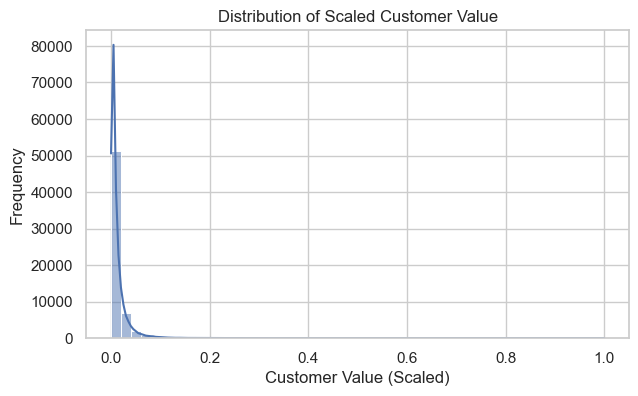

In [107]:
plt.figure(figsize=(7, 4))
sns.histplot(df_4['CustomerValue_Scaled'], bins=50, kde=True)
plt.title('Distribution of Scaled Customer Value')
plt.xlabel('Customer Value (Scaled)')
plt.ylabel('Frequency')
plt.show()

### 3 Machine Learning Approaches

In [69]:
df_4[['Length', 'Recency', 'FLIGHT_COUNT', 'Monetary', 'M2', 'CustomerValue_Scaled']].describe()

,Length,Recency,FLIGHT_COUNT,Monetary,M2,CustomerValue_Scaled
count,61878.000000,61878.000000,61878.000000,61878.000000,61878.000000,61878.000000
mean,1486.817609,172.011232,11.916497,11002.859163,0.643732,0.012824
std,847.605056,181.282700,14.094548,15369.776439,0.282815,0.020908
min,365.000000,0.000000,2.000000,0.000000,0.000000,0.000000
25%,734.000000,28.000000,3.000000,2762.000000,0.484974,0.002870
50%,1272.000000,105.000000,7.000000,5930.000000,0.619642,0.006496
75%,2181.000000,260.000000,15.000000,13056.750000,0.755119,0.014608
max,3437.000000,729.000000,213.000000,473748.000000,5.202103,1.000000


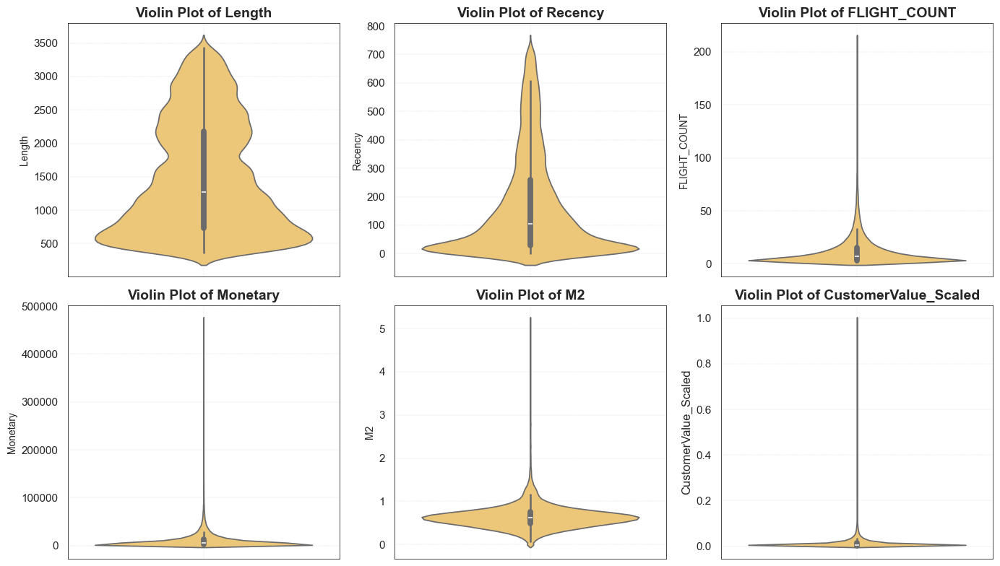

In [125]:
sns.set(style="whitegrid")

fig, axs = plt.subplots(2, 3, figsize=(14, 8))

sns.violinplot(y=df_4['Length'], ax=axs[0, 0], color='#FFCC66')
axs[0, 0].set_title('Violin Plot of Length', fontsize=14, weight='bold')
axs[0, 0].set_ylabel('Length', fontsize=10)
axs[0, 0].grid(True, which='both', axis='both', linestyle='--', linewidth=0.25)

sns.violinplot(y=df_4['Recency'], ax=axs[0, 1], color='#FFCC66')
axs[0, 1].set_title('Violin Plot of Recency', fontsize=14, weight='bold')
axs[0, 1].set_ylabel('Recency', fontsize=10)
axs[0, 1].grid(True, which='both', axis='both', linestyle='--', linewidth=0.25)

sns.violinplot(y=df_4['FLIGHT_COUNT'], ax=axs[0, 2], color='#FFCC66')
axs[0, 2].set_title('Violin Plot of FLIGHT_COUNT', fontsize=14, weight='bold')
axs[0, 2].set_ylabel('FLIGHT_COUNT', fontsize=10)
axs[0, 2].grid(True, which='both', axis='both', linestyle='--', linewidth=0.25)

sns.violinplot(y=df_4['Monetary'], ax=axs[1, 0], color='#FFCC66')
axs[1, 0].set_title('Violin Plot of Monetary', fontsize=14, weight='bold')
axs[1, 0].set_ylabel('Monetary', fontsize=10)
axs[1, 0].grid(True, which='both', axis='both', linestyle='--', linewidth=0.25)
sns.violinplot(y=df_4['M2'], ax=axs[1, 1], color='#FFCC66')
axs[1, 1].set_title('Violin Plot of M2', fontsize=14, weight='bold')
axs[1, 1].set_ylabel('M2', fontsize=10)
axs[1, 1].grid(True, which='both', axis='both', linestyle='--', linewidth=0.25)
sns.violinplot(y=df_4['CustomerValue_Scaled'], ax=axs[1, 2], color='#FFCC66')
axs[1, 2].set_title('Violin Plot of CustomerValue_Scaled', fontsize=14, weight='bold')
axs[1, 2].set_ylabel('CustomerValue_Scaled', fontsize=12)
axs[1, 2].grid(True, which='both', axis='both', linestyle='--', linewidth=0.25)
for ax in axs.flatten():
    for spine in ax.spines.values():
        spine.set_edgecolor('black')
        spine.set_linewidth(0.5)

plt.tight_layout()
plt.show()


### Length
**Length** represents the duration (in days) that customers have been members of the loyalty program. The violin plot for Length shows a fairly symmetric distribution with the majority of customers centered around the median value of 1272 days. This suggests that most customers have been with the program for a considerable amount of time. The distribution extends up to 3437 days, indicating that some customers have maintained their membership for nearly ten years. The presence of this long membership duration could indicate strong customer loyalty and engagement over time.

### Recency
**Recency** measures the number of days since a customer's last activity. The violin plot for Recency reveals a right-skewed distribution, where the majority of customers have engaged in recent activities within the last 100 days. This suggests that the program has been successful in keeping a large portion of its customer base active. However, the tail of the distribution stretches up to 729 days, indicating that there are some customers who have not engaged for nearly two years. This long tail could highlight a segment of lapsed customers who might benefit from re-engagement strategies.

### FLIGHT_COUNT
**FLIGHT_COUNT** indicates the number of flights taken by customers. The violin plot for FLIGHT_COUNT shows that most customers have taken between 2 to 15 flights, with the highest density around the lower counts. This indicates that while the majority of customers have relatively low flight activity, there are notable outliers with significantly higher flight counts, up to a maximum of 213 flights. These high-frequency flyers could be particularly valuable customers who contribute a substantial portion of the business and may warrant special attention and rewards.

### Monetary
**Monetary** represents the monetary value of transactions made by customers. The violin plot for Monetary shows a highly right-skewed distribution, with most customers having lower monetary values. The concentration of values at the lower end indicates that the majority of customers generate modest revenue. However, there are extreme outliers with monetary values reaching as high as 473,748. These high-value transactions, although rare, signify that there are some exceptionally valuable customers whose spending significantly exceeds the average. Identifying and nurturing these high-value customers could be crucial for revenue maximization.

### Monetary 2 (M2)
**M2** is another metric related to customer value, potentially a composite index. The violin plot for M2 depicts a distribution that is somewhat symmetric around a median value of 0.62. Most data points are concentrated below the value of 1, indicating that typical customer value scores are relatively low to moderate. However, there are a few high outliers with M2 values reaching up to 5.2. These high outliers suggest the presence of highly valuable customers who stand out significantly from the rest of the customer base. Understanding the characteristics of these top-performing customers could provide insights into what drives higher value.

### CustomerValue_Scaled
**CustomerValue_Scaled** is likely a normalized version of the customer value, scaled between 0 and 1. The violin plot for CustomerValue_Scaled shows a right-skewed distribution with the majority of customers clustered towards the lower end of the scale. This suggests that most customers have relatively low scaled values, with a few customers exhibiting significantly higher values, up to the maximum of 1. The presence of these high-scaled values indicates the existence of top-tier customers who perform exceptionally well on the value scale. Targeted marketing efforts towards these high-value customers could enhance retention and profitability.

In [72]:
features = ['Length', 'Recency', 'FLIGHT_COUNT', 'Monetary', 'M2', 'CustomerValue_Scaled']
df_4_selected = df_4[features]

In [73]:
scaler = StandardScaler()
df_4_selected = scaler.fit_transform(df_4_selected)

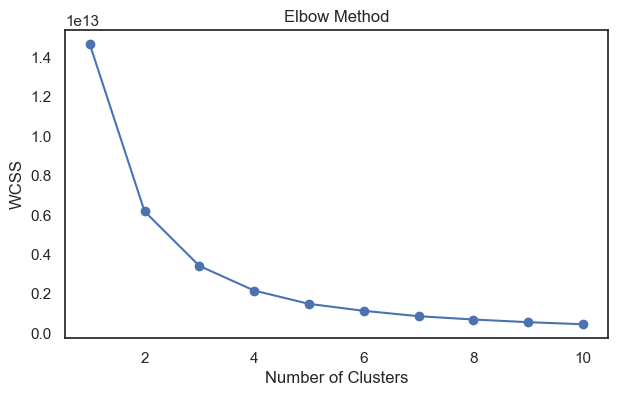

In [123]:
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt

wcss = []
for i in range(1, 11):  # Testing different numbers of clusters
    kmeans = KMeans(n_clusters=i, random_state=42)
    kmeans.fit(df_4_selected)
    wcss.append(kmeans.inertia_)

# Plotting the elbow graph
plt.figure(figsize=(7, 4))
plt.plot(range(1, 11), wcss, marker='o')
plt.title('Elbow Method')
plt.xlabel('Number of Clusters')
plt.ylabel('WCSS')
plt.show()

Based on the above graph, we will try 4-6 clusters in this data

In [75]:
from sklearn.metrics import silhouette_score

df_4 = df_4.reset_index(drop=True)
df_4_selected = df_4[features]
scaler = StandardScaler()
df_4_scaled = scaler.fit_transform(df_4_selected)
df_4_scaled = pd.DataFrame(df_4_scaled, columns=features)

# Perform K-means clustering with different numbers of clusters
for n_clusters in [4, 5, 6]:
    kmeans = KMeans(n_clusters=n_clusters, random_state=42)
    cluster_labels = kmeans.fit_predict(df_4_scaled)

    # Calculate silhouette score for each number of clusters
    silhouette_avg = silhouette_score(df_4_scaled, cluster_labels)

    # Add cluster labels back to df_4
    df_4[f'Cluster_{n_clusters}'] = cluster_labels

    print(f"For n_clusters = {n_clusters}, the average silhouette_score is : {silhouette_avg}")

For n_clusters = 4, the average silhouette_score is : 0.26620102678898766
For n_clusters = 5, the average silhouette_score is : 0.27572495397222857
For n_clusters = 6, the average silhouette_score is : 0.2877904774859817


Based on the silhouette scores, it appears that the score increases as the number of clusters goes from 4 to 6. While the silhouette scores are not particularly high, the increase does suggest that having 6 clusters may provide a better structure in the data, as the score is an indication of how similar an object is to its own cluster compared to other clusters.

In [76]:
cluster_options = [4, 5, 6] # clusters to be analysed

# Loop over each set of clusters
for n_clusters in cluster_options:
    cluster_label = f'Cluster_{n_clusters}'
    print(f"\nCluster Analysis for {n_clusters} Clusters:")

    # Display the contents of each cluster
    for cluster in range(n_clusters):
        print(f"\nEntries in Cluster {cluster}:")

        # Filter df_4 for the current cluster
        cluster_data = df_4[df_4[cluster_label] == cluster]

         # Calculate and display the mean values for each cluster
        means = cluster_data[features].mean()
        print(f"Mean values for Cluster {cluster}:", means)


Cluster Analysis for 4 Clusters:

Entries in Cluster 0:
Mean values for Cluster 0: Length                   901.113244
Recency                   96.640168
FLIGHT_COUNT               9.942478
Monetary                8427.775761
M2                         0.609537
CustomerValue_Scaled       0.009545
dtype: float64

Entries in Cluster 1:
Mean values for Cluster 1: Length                   2455.032278
Recency                    99.950023
FLIGHT_COUNT               11.644486
Monetary                10142.816882
M2                          0.637899
CustomerValue_Scaled        0.011496
dtype: float64

Entries in Cluster 2:
Mean values for Cluster 2: Length                   1922.151160
Recency                    26.701815
FLIGHT_COUNT               49.500345
Monetary                52643.153228
M2                          0.777843
CustomerValue_Scaled        0.065050
dtype: float64

Entries in Cluster 3:
Mean values for Cluster 3: Length                  1234.105299
Recency                  

#### Checking the stats distribution

In [119]:
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import pandas as pd

# Assuming df_4 is your DataFrame and it contains the features you listed
features = ['Length', 'Recency', 'FLIGHT_COUNT', 'Monetary', 'M2', 'CustomerValue_Scaled']

# Create a subplot figure for histograms and box plots
fig = make_subplots(rows=len(features), cols=2, subplot_titles=[f'{feature} Histogram' for feature in features] + [f'{feature} Box Plot' for feature in features])

# Define colors
colors = ['#FFCC66', '#66CCFF', '#FF6666', '#66FF66', '#CC66FF', '#FFCCFF']

# Plot histograms and box plots for each feature
for i, feature in enumerate(features):
    # Histogram
    fig.add_trace(go.Histogram(x=df_4[feature], nbinsx=50, name=f'{feature} Histogram', marker_color=colors[i % len(colors)]), row=i+1, col=1)
    
    # Box plot
    fig.add_trace(go.Box(x=df_4[feature], name=f'{feature} Box Plot', marker_color=colors[i % len(colors)]), row=i+1, col=2)

# Update layout for aesthetics
fig.update_layout(
    height=1000, width=700, title_text="Histograms and Box Plots of Various Metrics",
    showlegend=False,
    template="plotly_white",
    title_font=dict(size=12, family='Arial, bold')
)

# Show the figure
fig.show()

In [78]:
from scipy.stats import shapiro

# Perform Shapiro-Wilk test for normality test
for feature in features:
    stat, p = shapiro(df_4[feature])
    print(f'Shapiro-Wilk test for {feature}: Statistics={stat:.3f}, p-value={p:.3g}')
    # Interpretation
    alpha = 0.05
    if p > alpha:
        print(f'{feature} looks Gaussian (fail to reject H0)')
    else:
        print(f'{feature} does not look Gaussian (reject H0)')


Shapiro-Wilk test for Length: Statistics=0.925, p-value=2.59e-94
Length does not look Gaussian (reject H0)
Shapiro-Wilk test for Recency: Statistics=0.839, p-value=1.87e-114
Recency does not look Gaussian (reject H0)
Shapiro-Wilk test for FLIGHT_COUNT: Statistics=0.672, p-value=8.58e-135
FLIGHT_COUNT does not look Gaussian (reject H0)
Shapiro-Wilk test for Monetary: Statistics=0.591, p-value=1.78e-141
Monetary does not look Gaussian (reject H0)
Shapiro-Wilk test for M2: Statistics=0.850, p-value=1.59e-112
M2 does not look Gaussian (reject H0)
Shapiro-Wilk test for CustomerValue_Scaled: Statistics=0.501, p-value=1.07e-147
CustomerValue_Scaled does not look Gaussian (reject H0)


Not really surprised, but based on the results of the Shapiro-Wilk tests, all features in dataset (Length, Recency, FLIGHT_COUNT, Monetary, M2, CustomerValue_Scaled) significantly deviate from a normal distribution. The statistics are well below 1, and the p-values are effectively zero, strongly indicating non-normality for each of these features. So will need median in our summary analysis

In [79]:
def create_cluster_summary_table(df, n_clusters, cluster_label):
    # Initialize a DataFrame to store the results
    stats = ['median', 'mean']
    results = pd.DataFrame(index=range(n_clusters), columns=['Length', 'Recency', 'FLIGHT_COUNT', 'Monetary', 'M2', 'CustomerValue_Scaled'])

    for cluster in range(n_clusters):
        # Extract data for the current cluster
        cluster_data = df_4[df_4[cluster_label] == cluster]

        # Calculate median for Recency and mean for Frequency and Monetary
        results.loc[cluster, 'Length'] = cluster_data['Length'].median()
        results.loc[cluster, 'Recency'] = cluster_data['Recency'].median()
        results.loc[cluster, 'FLIGHT_COUNT'] = cluster_data['FLIGHT_COUNT'].median()
        results.loc[cluster, 'M2'] = cluster_data['M2'].median()
        results.loc[cluster, 'Monetary'] = cluster_data['Monetary'].median()
        results.loc[cluster, 'CustomerValue_Scaled'] = cluster_data['CustomerValue_Scaled'].median()
    return results


In [80]:
# Calculate the summarie
cluster_labels = ['Cluster_4', 'Cluster_5', 'Cluster_6']
summaries = {}

for label in cluster_labels:
    summaries[label] = create_cluster_summary_table(df_4, int(label.split('_')[-1]), label)

In [81]:
# Print out each summary table
for label, summary in summaries.items():
    print(f"\nCluster Analysis for {label.split('_')[-1]} Clusters:")
    display(summary)


Cluster Analysis for 4 Clusters:


,Length,Recency,FLIGHT_COUNT,Monetary,M2,CustomerValue_Scaled
0,851.0,76.0,8.0,6275.0,0.599035,0.006905
1,2419.0,72.0,9.0,7868.0,0.619715,0.008577
2,1929.0,11.0,45.0,44317.0,0.716863,0.051092
3,1028.0,459.0,3.0,2630.0,0.624633,0.002696



Cluster Analysis for 5 Clusters:


,Length,Recency,FLIGHT_COUNT,Monetary,M2,CustomerValue_Scaled
0,1701.5,17.0,32.0,29701.5,0.682871,0.032926
1,2420.0,88.0,7.0,6357.0,0.610849,0.006823
2,2165.0,7.0,69.0,77012.0,0.766614,0.098293
3,1007.0,473.0,3.0,2656.0,0.637493,0.00271
4,834.0,84.0,7.0,5666.0,0.588738,0.006272



Cluster Analysis for 6 Clusters:


,Length,Recency,FLIGHT_COUNT,Monetary,M2,CustomerValue_Scaled
0,836.0,81.0,7.0,5782.0,0.588986,0.006435
1,2427.0,86.0,8.0,6445.0,0.605098,0.006953
2,2175.0,7.0,71.0,79504.5,0.769721,0.102652
3,1012.0,469.0,3.0,2531.0,0.590745,0.002679
4,1145.0,188.0,5.0,6800.0,1.297829,0.005113
5,1745.0,17.0,33.0,30593.5,0.677679,0.034278


### Cluster Analysis Interpretation:

Cluster Analysis for 4 Clusters:
1. Cluster 0: Group with frequent and recent interactions, moderate spending, and a fairly high customer value, indicative of loyal, regular customers.
2. Cluster 1: Customers with the least engagement and spending, showing significant recency which could *indicate slipping or new customers who have not yet fully engaged*.
3. Cluster 2: High-value customers characterized by very frequent transactions, extremely high monetary contributions, and the best customer value scores,we could say they are the top-tier customers.
4. Cluster 3: Customers with high spending and moderate engagement levels, likely to be profitable and loyal with some potential to be converted into top-tier customers.

Cluster Analysis for 5 Clusters:
1. Cluster 0:The least engaged and spending group with the highest recency, potentially at-risk or newer customers who need targeted engagement strategies.
2. Cluster 1:Mid-level customers with moderate engagement and spending, showing potential for growth into more profitable segments.
3. Cluster 2:The elite segment, exhibiting the highest engagement and spending, and the best customer value scores; these are premium customers.
4. Cluster 3:Lower-tier but somewhat engaged customers, spending modest amounts with potential for increased engagement.
5. Cluster 4:Highly engaged customers with substantial monetary contributions, showing very good customer value and possibly secondary only to the elite segment in Cluster 2.

Cluster Analysis for 6 Clusters:
1. Cluster 0:Moderately engaged customers with above-average spending and engagement, showing potential for further development.
2. Cluster 1:The most disengaged group with the lowest frequency and monetary contributions and high recency, indicating a clear risk of churn.
3. Cluster 2:High-value customers with significant engagement and high spending, critical for revenue with a good customer value index.
4. Cluster 3:Solidly performing customers with good engagement and spending, potentially reliable contributors to business revenue.
5. Cluster 4:Top-tier customers, showing the highest engagement, spending, and customer value, essential for retaining as key revenue drivers.
6. Cluster 5:Less frequent interaction but still maintaining moderate spending; these customers might require specific strategies to boost their engagement.

In [82]:
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt

# Assuming df_4_scaled is already scaled data
pca = PCA(n_components=2)
pca_result = pca.fit_transform(df_4_scaled)

# Add PCA results
df_4['PCA1'] = pca_result[:, 0]
df_4['PCA2'] = pca_result[:, 1]
if pca.n_components == 3:
    df_4['PCA3'] = pca_result[:, 2]


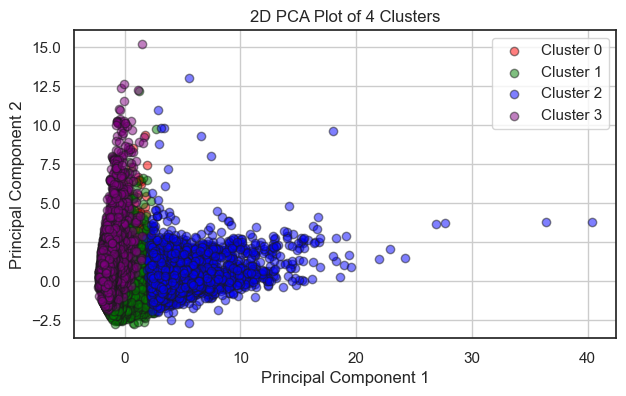

In [120]:
# Adjust colors for 4 clusters
colors = ['red', 'green', 'blue', 'purple']  # Colors for each of the 4 clusters

plt.figure(figsize=(7, 4))
for i in range(4):  # Loop through each cluster (0 to 3)
    plt.scatter(df_4[df_4['Cluster_4'] == i]['PCA1'], df_4[df_4['Cluster_4'] == i]['PCA2'],
                color=colors[i], label=f'Cluster {i}', alpha=0.5, edgecolor='k')

plt.title('2D PCA Plot of 4 Clusters')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.legend()
plt.grid(True)
plt.show()


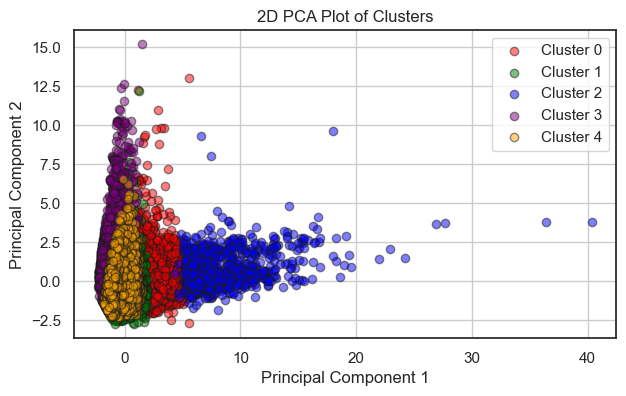

In [121]:
# Plotting the results
plt.figure(figsize=(7,4))
colors = ['red', 'green', 'blue', 'purple', 'orange']

for i in range(5):  # Change this range if you have a different number of clusters
    plt.scatter(df_4[df_4[f'Cluster_5'] == i]['PCA1'], df_4[df_4[f'Cluster_5'] == i]['PCA2'],
                color=colors[i], label=f'Cluster {i}', alpha=0.5, edgecolor='k')

plt.title('2D PCA Plot of Clusters')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.legend()
plt.grid(True)
plt.show()


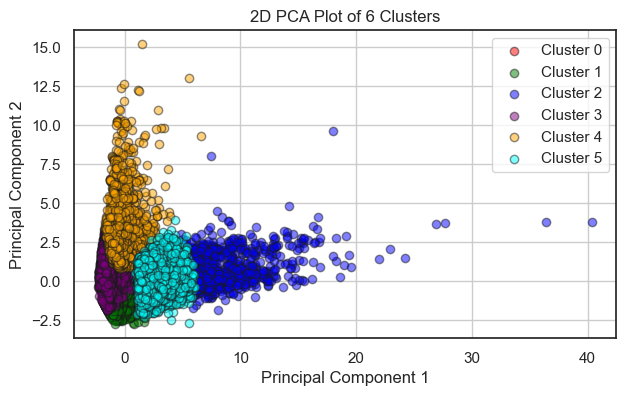

In [122]:
# Adjust colors for 6 clusters
colors = ['red', 'green', 'blue', 'purple', 'orange', 'cyan']

plt.figure(figsize=(7,4))
for i in range(6):  # Loop through each cluster (0 to 5)
    plt.scatter(df_4[df_4['Cluster_6'] == i]['PCA1'], df_4[df_4['Cluster_6'] == i]['PCA2'],
                color=colors[i], label=f'Cluster {i}', alpha=0.5, edgecolor='k')

plt.title('2D PCA Plot of 6 Clusters')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.legend()
plt.grid(True)
plt.show()


Practically speaking, more clusters mean more complex strategies and potentially higher costs in terms of personalized marketing and customer relationship management. So, 4 clusters could be ideal for broad segmentation strategies. Suitable if the business needs a simple and straightforward approach to customer segmentation. 5 clusters may provides a balance between detail and manageability so this cluster offers additional insights that are actionable and valuable. The last, 6 clusters is best for detailed segmentation where each cluster is distinctly different and can be targeted with specific strategies. This will be ideal if the business has the resources to manage such detailed segments and if each segment is substantial enough to warrant individual attention (?).